In [1]:
# %pip install auraloss
# %pip install tensorflow --force-reinstall -U
# %pip install tensorrt -U
# %pip install librosa
# %pip install intel-extension-for-tensorflow[cpu]
# %pip uninstall intel-extension-for-tensorflow[cpu] -y
# %pip uninstall tensorflow -y
# %pip install tensorflow-cpu -U
# %pip install setuptools -U --force-reinstall


In [2]:
# based on LSTM from https://github.com/GuitarML/GuitarLSTM

In [3]:
import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras import layers as L
import tensorflow.keras.backend as K
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import HTML, Audio
import librosa
from scipy import signal
import tensorboard
import datetime
# import auraloss # audio loss functions from steinmetz


In [4]:
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))
print("Setting up logging")
log_dir = "logs/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
log_fit = log_dir + "/fit"
# tf.debugging.experimental.enable_dump_debug_info(log_dir, tensor_debug_mode="FULL_HEALTH", circular_buffer_size=-1)

Num GPUs Available:  1
Setting up logging
INFO:tensorflow:Enabled dumping callback in thread MainThread (dump root: logs/20240420-225033, tensor debug mode: FULL_HEALTH)


In [5]:
# set random seed for reproducibility
# np.random.seed(1001)
# tf.random.set_seed(1001)

In [6]:
def max_over_interval(x, interval=1, sample_rate=44100):
    samples_per_segment = int(sample_rate * interval)
    num_segments = x.shape[0] // samples_per_segment  # Ensure integer division
    max_levels = np.max(np.split(x[:num_segments * samples_per_segment], num_segments), axis=1)
    return max_levels

def viz_audio(x, y=None, interval=1, sample_rate=44100,
                      title='Audio Signal', x_legend='Input' , y_legend='Output',
                      figsize=(10, 4)):
 
    max_levels = max_over_interval(x, interval, sample_rate)
    num_segments = max_levels.shape[0]    
    seconds = np.arange(0, num_segments) * interval
    plt.figure(figsize=figsize)
    plt.plot(seconds, max_levels, marker='o')
    if y is not None:
        max_levels_y = max_over_interval(y, interval, sample_rate)
        plt.plot(seconds, max_levels_y, marker='x', color='red')
        plt.legend([x_legend, y_legend])
    plt.xlabel('Time (s)')
    plt.ylabel('Max Amplitude')
    plt.title(f'Maximum Sound Level per {interval:.1f}s Segment')
    plt.grid(True)
    plt.show()

In [7]:
# Let's load the audio file
audio_x_file = 'Ben Direct FP'
# audio_x_file = 'ht1-input_test'
# audio_x_file = 'ht1-input_train'
audio_y_file = 'Ben Vox FP'
# audio_y_file = 'ht1-target_test'
# audio_y_file = 'ht1-target_train'
x, sample_rate = librosa.load(f'../audio/{audio_x_file}.wav', sr=None, dtype=np.float32)
x = (x / np.max(np.abs(x)))  # Normalize to [-1, 1]
y_gold, _ = librosa.load(f'../audio/{audio_y_file}.wav', sr=None, dtype=np.float32)
y_gold = y_gold / np.max(np.abs(y_gold))  # Normalize to [-1, 1]
print(f"Loded audio files {audio_x_file} and {audio_y_file} with sample rate {sample_rate}")
print(f"Total seconds of audio: {x.shape[0] / sample_rate:.2f}s")

Loded audio files Ben Direct FP and Ben Vox FP with sample rate 44100
Total seconds of audio: 312.00s


Total seconds of audio after reduction 156.0
Input size (13759200,) and Target size (13759200,)
Reduced Input size (6879600,) and Reduced Target size (6879600,)
Train size (5503680, 1, 1) and Test size (1375920, 1, 1)
Input audio


Target audio


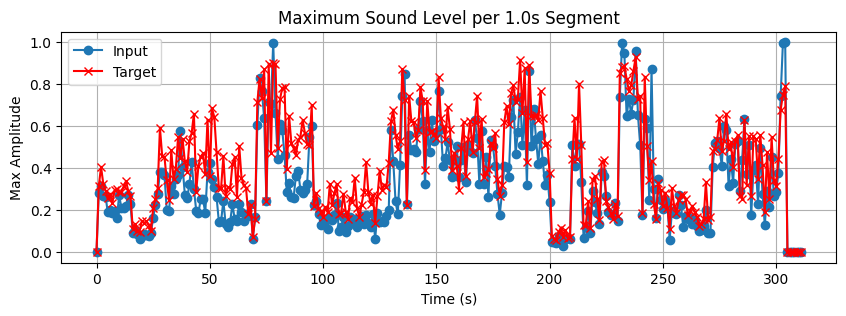

In [8]:

REDUCE = 2 #let's cut down the sample by REDUCE factor
train_size = 0.8  # 80% of the data is used for training
length = x.shape[0] // REDUCE
x_reduced = x[:length].flatten()
y_gold_reduced = y_gold[:length].flatten()

x_train = x_reduced[:int(length * train_size)]
y_gold_train = y_gold_reduced[:int(length * train_size)]
x_test = x_reduced[int(length * train_size):]
y_gold_test = y_gold_reduced[int(length * train_size):]

x_tensor = x_train.reshape(-1, 1, 1) # Shape: [N, L, Features]
y_gold_tensor = y_gold_train.reshape(-1, 1, 1) # Must match x_tensor's shape
x_test_tensor = x_test.reshape(-1, 1, 1)
y_gold_test_tensor = y_gold_test.reshape(-1, 1, 1)

print(f"Total seconds of audio after reduction {x_reduced.shape[0]/sample_rate}")
print(f"Input size {x.shape} and Target size {y_gold.shape}")
print(f"Reduced Input size {x_reduced.shape} and Reduced Target size {y_gold_reduced.shape}")
print(f"Train size {x_tensor.shape} and Test size {x_test_tensor.shape}")

print("Input audio")
display(Audio(x_reduced, rate=sample_rate))
print("Target audio")
display(Audio(y_gold_reduced, rate=sample_rate))

viz_audio(x, y=y_gold, interval=1.0, sample_rate=sample_rate ,title='Audio Signal', x_legend='Input' , y_legend='Target' , figsize=(10, 3))

2024-04-20 22:50:37.284183: I metal_plugin/src/device/metal_device.cc:1154] Metal device set to: Apple M1
2024-04-20 22:50:37.284267: I metal_plugin/src/device/metal_device.cc:296] systemMemory: 16.00 GB
2024-04-20 22:50:37.284299: I metal_plugin/src/device/metal_device.cc:313] maxCacheSize: 5.33 GB
2024-04-20 22:50:37.284344: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:305] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2024-04-20 22:50:37.284389: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:271] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


Normalized input size (5503680, 1, 1)
Normalized target size (5503680, 1, 1)


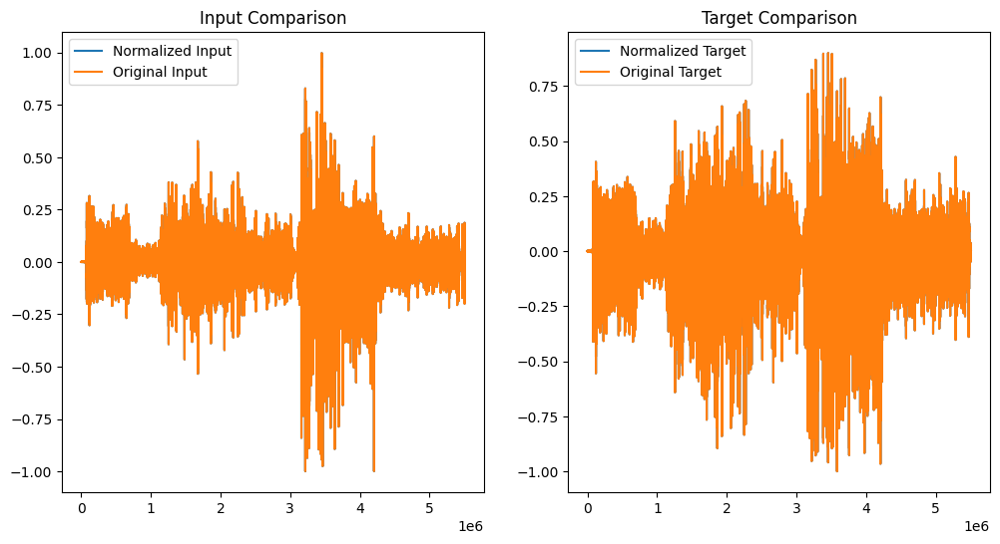

In [9]:
#normalize or no?
NORMALIZE = True

if NORMALIZE:
    x_tensor_norm = x_tensor / tf.reduce_max(tf.abs(x_tensor))
    y_gold_tensor_norm = y_gold_tensor / tf.reduce_max(tf.abs(y_gold_tensor))
else:
    x_tensor_norm = x_tensor
    y_gold_tensor_norm = y_gold_tensor

if NORMALIZE:
    print("Normalized input size", x_tensor.shape)
    print("Normalized target size", y_gold_tensor.shape)
    fig, axs = plt.subplots(1, 2, figsize=(12, 6))  # 1 row, 2 columns
    axs[0].plot(tf.squeeze(x_tensor_norm).numpy(), label="Normalized Input")
    axs[0].plot(tf.squeeze(x_tensor).numpy(), label="Original Input")
    axs[0].legend()
    axs[0].set_title("Input Comparison")
    axs[1].plot(tf.squeeze(y_gold_tensor_norm).numpy(), label="Normalized Target")
    axs[1].plot(tf.squeeze(y_gold_tensor).numpy(), label="Original Target")
    axs[1].legend()
    axs[1].set_title("Target Comparison")
    plt.show()
else:
    print("Not normalized.")

In [10]:
# Filter? Found this at blackboxRNNmodel
# https://github.com/arvidfalch/blackboxRNNmodeling/blob/main/main_training.ipynb
# Wether to filter the audio
filtered = False
x_unfiltered = x_tensor_norm
y_gold_unfiltered = y_gold_tensor_norm

if filtered is True:
    dry = tf.squeeze(x_unfiltered).numpy()
    wet = tf.squeeze(y_gold_unfiltered).numpy()

    # Creating a high pass filter 
    numtaps = 91
    cutoff = 0.015
    b = signal.firwin(numtaps, cutoff, width=None, window='hann', pass_zero='highpass')

    # Creating a lowpass filter
    numtaps = 41
    cutoff = 0.92
    b2 = signal.firwin(numtaps, cutoff, width=None, window='hann', pass_zero='lowpass')

    # high pass audio to emphasize high frequency information, low pass to avoid aliasing artifacts
    # High Pass Filter
    dry = signal.lfilter(b, 1, dry)
    wet = signal.lfilter(b, 1, wet)
    # Low Pass Filter
    dry = signal.lfilter(b2, 1, dry)
    wet = signal.lfilter(b2, 1, wet)

    print("Normalized input")
    display(Audio(tf.squeeze(x_tensor_norm).numpy(), rate=sample_rate))
    print("Filtered input")
    display(Audio(dry, rate=sample_rate))
    print("Normalized target")
    display(Audio(tf.squeeze(y_gold_tensor_norm).numpy(), rate=sample_rate))
    print("Filtered target")
    display(Audio(wet, rate=sample_rate))

    print("filtered shapes", x_tensor_norm.shape)
    fig, axs = plt.subplots(1, 2, figsize=(12, 6))  # 1 row, 2 columns
    axs[0].plot(tf.squeeze(x_unfiltered).numpy(), label="Original Input")
    axs[0].plot(tf.squeeze(x_tensor_norm).numpy(), label="Filtered Input")
    axs[0].legend()
    axs[0].set_title("Input Comparison")
    axs[1].plot(tf.squeeze(y_gold_unfiltered).numpy(), label="Original Target")
    axs[1].plot(tf.squeeze(y_gold_tensor_norm).numpy(), label="Filtered Target")
    axs[1].legend()
    axs[1].set_title("Target Comparison")
    plt.show()
    x_tensor_norm = dry.reshape(-1, 1, 1)
    y_gold_tensor_norm = wet.reshape(-1, 1, 1)

else:
    print("Not filtered")
    x_tensor_norm = x_unfiltered
    y_gold_tensor_norm = y_gold_unfiltered

Not filtered


In [11]:
class CloseToInputInitializer(tf.keras.initializers.Initializer):
    def __init__(self, input_data):
        # Calculate the mean of the input data
        self.mean = np.mean(input_data/2) 
        
    def __call__(self, shape, dtype=None):
        # Initialize biases to the mean of the input data
        # Weights can be initialized to small random values or zeros
        bias = tf.fill(shape, self.mean)
        return bias

    def get_config(self):  # For saving and loading models
        return {"mean": self.mean}


In [12]:
tf.keras.backend.clear_session()

hidden_size = 128
conv1d_strides = 3  # less is slower 
conv1d_filters = 36 # more is slower

# model = keras.Sequential()
# model.add(L.InputLayer(shape=(None, 1)))
# model.add(L.Conv1D(conv1d_filters, 12,strides=conv1d_strides, padding='same'))
# model.add(L.Conv1D(conv1d_filters, 3, strides=conv1d_strides, padding='same'))
# model.add(L.LSTM(hidden_size, return_sequences=True, stateful=False, kernel_regularizer=keras.regularizers.l1_l2(l1=0.1, l2=0.01))) # default is return_sequences=False and stateful=False
# # model.add(L.Dense(hidden_size))
# # model.add(L.Dense(hidden_size, kernel_regularizer=keras.regularizers.l1_l2(l1=0.1, l2=0.01)))
# model.add(L.Dense(1))
# model.add(L.Add()) # RTNeural doesn't know anything about Add layer, so leaving out recurrency
# # model.add(L.Dense(1, bias_initializer=CloseToInputInitializer(x_tensor_norm.flatten())))


inputs = L.Input(shape=(None, 1))
x = L.Conv1D(conv1d_filters, 12, strides=conv1d_strides, padding='same')(inputs)
x = L.Conv1D(conv1d_filters, 3, strides=conv1d_strides, padding='same')(x)
lstm_output = L.LSTM(hidden_size, return_sequences=True, stateful=False, kernel_regularizer=keras.regularizers.l1_l2(l1=0.1, l2=0.01))(x)
dense_output = L.Dense(hidden_size)(lstm_output)

# Additional convolutional layer to match the shape of the LSTM output
x_skip = L.Conv1D(hidden_size, 1, padding='same')(inputs)

# Add skip connection
x = L.Add()([lstm_output, x_skip])
outputs = L.Dense(1)(x)

model = keras.Model(inputs=inputs, outputs=outputs)

model.summary()




Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, None, 1)   │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d (Conv1D)     │ (None, None, 36)  │        468 │ input_layer[0][0] │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_1 (Conv1D)   │ (None, None, 36)  │      3,924 │ conv1d[0][0]      │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ lstm (LSTM)         │ (None, None, 128) │     84,480 │ conv1d_1[0][0]    │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_2 (Conv1D)   │ (None, None, 128) │        256 │ input_layer[0][0] │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add (Add)           │ (None, None, 128) │          0 │ lstm[0][0],       │
│                     │                   │            │ conv1d_2[0][0]    │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_1 (Dense)     │ (None, None, 1)   │        129 │ add[0][0]         │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 89,257 (348.66 KB)

 Trainable params: 89,257 (348.66 KB)

 Non-trainable params: 0 (0.00 B)

In [13]:
test_without_training = False
if test_without_training:

    y_pred_raw = model.predict(x_test_tensor, verbose=1)
    print("X tensor shape", x_test_tensor.shape)
    print("y_pred_raw shape", np.shape(y_pred_raw))
    print("Untrained model output")
    display(Audio(y_pred_raw.squeeze(), rate=sample_rate))
    viz_audio(y_pred_raw.squeeze(), y=y_gold_test.squeeze(), interval=1.0, sample_rate=sample_rate,
            x_legend='Untrained Model', y_legend='Target',)
else:
    print("Model not tested without training")


Model not tested without training


In [14]:
# custom loss functions to try
def spectral_loss(y_true, y_pred):
    stft_true = tf.signal.stft(y_true, frame_length=256, frame_step=64)
    stft_pred = tf.signal.stft(y_pred, frame_length=256, frame_step=64)
    return tf.reduce_mean(tf.abs(stft_true - stft_pred))

# https://github.com/GuitarML/GuitarLSTM/blob/main/train.py
def pre_emphasis_filter(x, coeff=0.95):
    return tf.concat([x, x - coeff * x], 1)
    
def error_to_signal(y_true, y_pred): 
    """
    Error to signal ratio with pre-emphasis filter:
    """
    y_true, y_pred = pre_emphasis_filter(y_true), pre_emphasis_filter(y_pred)
    return K.sum(tf.pow(y_true - y_pred, 2), axis=0) / K.sum(tf.pow(y_true, 2), axis=0) + 1e-10

In [15]:
NUM_EPOCHS = 100
lr = 0.000001
min_lr = lr
# min_lr = 0.00001
n_epochs_full_predict = 100
window_size = 100  # Length of the window
shift = 1          # Number of steps to shift the window
# BATCH_SIZE = 4096
BATCH_SIZE = sample_rate // 10
# SHUFFLE_BUFFER_SIZE = 10000
SHUFFLE_BUFFER_SIZE = BATCH_SIZE * 10

# various methods of making the dataset attempted
# dataset = keras.utils.timeseries_dataset_from_array(x_tensor_norm, y_gold_tensor_norm, 
#                                                     sequence_length=window_size, sequence_stride=shift, 
#                                                     sampling_rate=1, batch_size=batch_size, shuffle=False, 
#                                                     seed=None, start_index=None, end_index=None)

dataset = tf.data.Dataset.from_tensor_slices((x_tensor, y_gold_tensor))
# dataset = dataset.window(size=window_size, shift=shift, drop_remainder=True)
# dataset = dataset.flat_map(lambda x, y: tf.data.Dataset.zip((x.batch(window_size), y.batch(window_size))))
dataset = dataset.shuffle(SHUFFLE_BUFFER_SIZE).batch(BATCH_SIZE).prefetch(tf.data.AUTOTUNE)
# dataset = dataset.batch(BATCH_SIZE).prefetch(tf.data.AUTOTUNE)

optimizer = keras.optimizers.Adam(learning_rate=lr)
# loss_function = keras.losses.MeanSquaredError()
# loss_function = error_to_signal
loss_function = spectral_loss
metric_function = error_to_signal
model.compile(optimizer=optimizer, loss=loss_function, metrics=[metric_function])

class PredictionCallback(tf.keras.callbacks.Callback):
    def __init__(self, x_test, capture_every_n_epochs=100):
        super(PredictionCallback, self).__init__()
        self.x_test = x_test
        self.predictions = []
        self.capture_every_n_epochs = capture_every_n_epochs

    def on_epoch_end(self, epoch, logs=None):
        # only capture every "n" epochs
        if (epoch + 1) % self.capture_every_n_epochs == 0:
            y_pred = self.model.predict(self.x_test, verbose=1).flatten()
            self.predictions.append(y_pred)
            print(f"Captured predictions at epoch: {epoch + 1}")

predictions_callback = PredictionCallback(x_test=x_tensor, capture_every_n_epochs=n_epochs_full_predict)

early_stopping = keras.callbacks.EarlyStopping(monitor="loss", min_delta=0, patience=10, 
    verbose=True, mode="min", baseline=None, restore_best_weights=True, start_from_epoch=0)

tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_fit, histogram_freq=1)

# Early stopping and learning rate scheduler setup
reduce_lr = keras.callbacks.ReduceLROnPlateau(monitor='loss', factor=0.1, patience=1, min_lr=min_lr, mode='min', verbose=1)

# Train the model
# history = model.fit(dataset, epochs=NUM_EPOCHS, callbacks=[early_stopping, reduce_lr, predictions_callback, tensorboard_callback], verbose=1)
history = model.fit(dataset, epochs=NUM_EPOCHS, verbose=1)

Epoch 1/100


2024-04-20 22:50:48.475968: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:117] Plugin optimizer for device_type GPU is enabled.


1248/1248 ━━━━━━━━━━━━━━━━━━━━ 101s 77ms/step - error_to_signal: 1.0008 - loss: 97.3075
Epoch 2/100
1248/1248 ━━━━━━━━━━━━━━━━━━━━ 96s 77ms/step - error_to_signal: 1.0008 - loss: 95.0081
Epoch 3/100
1248/1248 ━━━━━━━━━━━━━━━━━━━━ 100s 80ms/step - error_to_signal: 1.0008 - loss: 92.7393
Epoch 4/100
1248/1248 ━━━━━━━━━━━━━━━━━━━━ 94s 75ms/step - error_to_signal: 1.0008 - loss: 90.4962
Epoch 5/100
1248/1248 ━━━━━━━━━━━━━━━━━━━━ 98s 79ms/step - error_to_signal: 1.0008 - loss: 88.2802
Epoch 6/100
1248/1248 ━━━━━━━━━━━━━━━━━━━━ 102s 82ms/step - error_to_signal: 1.0008 - loss: 86.0939
Epoch 7/100
1248/1248 ━━━━━━━━━━━━━━━━━━━━ 97s 77ms/step - error_to_signal: 1.0008 - loss: 83.9358
Epoch 8/100
1248/1248 ━━━━━━━━━━━━━━━━━━━━ 102s 81ms/step - error_to_signal: 1.0008 - loss: 81.8039
Epoch 9/100
1248/1248 ━━━━━━━━━━━━━━━━━━━━ 102s 82ms/step - error_to_signal: 1.0008 - loss: 79.6982
Epoch 10/100
1248/1248 ━━━━━━━━━━━━━━━━━━━━ 99s 80ms/step - error_to_signal: 1.0008 - loss: 77.6196
Epoch 11/100
124

In [16]:
import model_utils
import importlib
importlib.reload(model_utils)
save = True

if save:
    model_utils.save_model(model, f'{audio_x_file}_lstm_tf_real_{hidden_size}.json')
    print(f"Model saved with name {audio_x_file}_lstm_tf_real_{hidden_size}.json")



Skipping layer: <InputLayer name=input_layer, built=True>
Model saved with name Ben Direct FP_lstm_tf_real_128.json


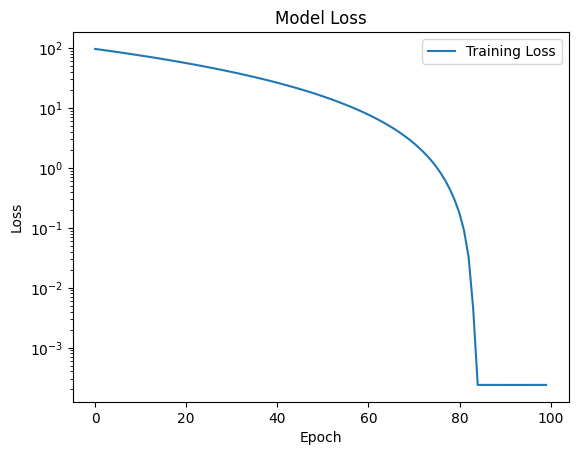

In [17]:
# plot the loss
plt.plot(history.history['loss'], label='Training Loss')
plt.title('Model Loss')
plt.yscale('log')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend()
plt.show()

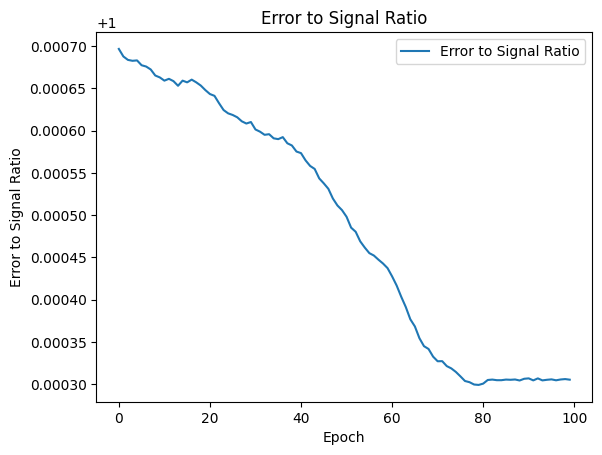

In [18]:
#plot error to signal ratio
plt.plot(history.history['error_to_signal'], label='Error to Signal Ratio')
plt.title('Error to Signal Ratio')
# plt.yscale('log')
plt.ylabel('Error to Signal Ratio')
plt.xlabel('Epoch')
plt.legend()
plt.show()

In [19]:
x_test_tensor.shape

(1375920, 1, 1)

In [28]:
# predict on train set
# y_pred = model.predict(x_tensor).flatten()
# predict on test set
y_pred_test = model.predict(x_test_tensor).flatten()


42998/42998 ━━━━━━━━━━━━━━━━━━━━ 364s 8ms/step
Test original


ValueError: Array audio input must be a 1D or 2D array

In [29]:

# listen to output
# print("Train set")
# display(Audio(y_pred, rate=sample_rate))
# print("Train Target")
# display(Audio(y_gold_train, rate=sample_rate))
print("Test original")
display(Audio(x_test_tensor.flatten(), rate=sample_rate))
print("Test predicted")
display(Audio(y_pred_test, rate=sample_rate))
print("Test Target")
display(Audio(y_gold_test, rate=sample_rate))

Test original


Test predicted


Test Target


In [27]:
print(np.max(y_pred_test))

0.0021762177


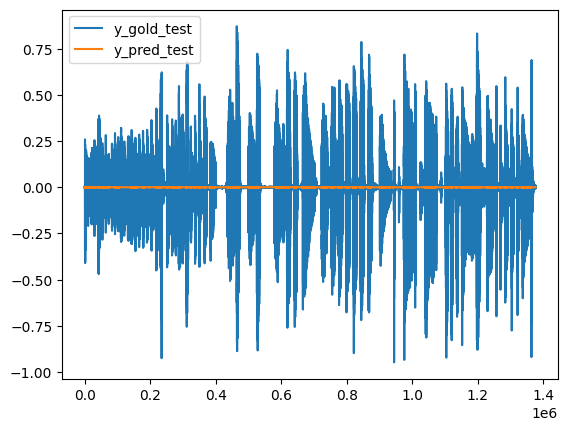

In [21]:
plt.plot(y_gold_test)
plt.plot(y_pred_test)
# plt.plot(x_test)
plt.legend(['y_gold_test', 'y_pred_test', 'x'])
plt.show()

#

(1375920,)
(1375920,)


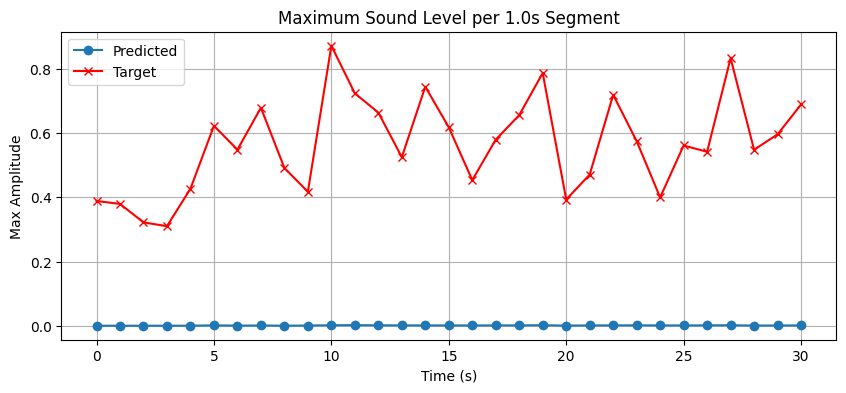

In [25]:
print(y_gold_test.shape)
print(y_pred_test.shape)

# viz_audio(y_gold)

viz_audio(y_pred_test, y=y_gold_test, interval=1.0, sample_rate=sample_rate,
            x_legend='Predicted', y_legend='Target',)

(1375920,)
(1375920,)


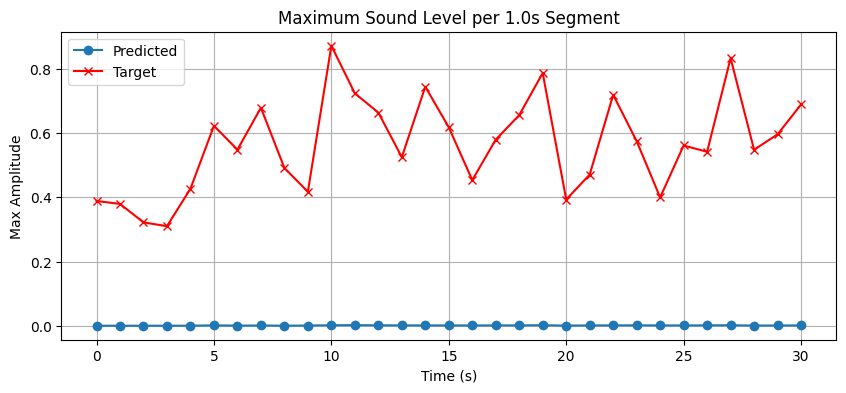

In [23]:
# plot the predictions versus gold

print(y_gold_test.shape)
print(y_pred_test.shape)

# viz_audio(y_gold)

viz_audio(y_pred_test, y=y_gold_test, interval=1.0, sample_rate=sample_rate,
            x_legend='Predicted', y_legend='Target',)


In [26]:
# Let's compute error to signal ratio for the trained model

ESR = np.sum(np.abs(y_gold_test - y_pred_test)**2) / np.sum(np.abs(y_gold_test)**2)
print(f'Error to Signal Ratio: {ESR}')

Error to Signal Ratio: 1.0011194944381714


In [30]:
# run the whole input
y_pred_full = model.predict(x_tensor, verbose=1).flatten()
# save it
np.save(f'{audio_x_file}_lstm_tf_real_{hidden_size}_full.npy', y_pred_full)
# listen to it
print("Full original")
display(Audio(x_tensor.flatten(), rate=sample_rate))
print("Full predicted")
display(Audio(y_pred_full, rate=sample_rate))
print("Full Target")
display(Audio(y_gold_tensor.flatten(), rate=sample_rate))

141064/171990 ━━━━━━━━━━━━━━━━━━━━ 5:06 10ms/step